# Lab 2: Базові алгоритми навчання без учителя та обробка текстових даних (Scikit-learn lib)

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# from sklearn.datasets import load_wine, load_digits

# from sklearn.preprocessing import StandardScaler
# from sklearn.decomposition import PCA
# from sklearn.manifold import TSNE

import seaborn as sns

1. Зниження розмірності і візуалізація даних
Застосуйте методи зниження розмірності sklearn.decomposition.PCA і sklearn.manifold.TSNE для візуалізації даних, з якими ви працювали в лабораторній № 1 (знижуючи розмірність до двох). Візуалізуйте результат.
Приклад: https://github.com/natsakh/Data-Analysis/tree/main/Pr_3


In [3]:
df = pd.read_csv('../Lab_1/letter+recognition/letter-recognition.data')

In [4]:
df.head()

,lettr,x-box,y-box,width,high,onpix,x-bar,y-bar,x2bar,y2bar,xybar,x2ybr,xy2br,x-ege,xegvy,y-ege,yegvx
0,T,2,8,3,5,1,8,13,0,6,6,10,8,0,8,0,8
1,I,5,12,3,7,2,10,5,5,4,13,3,9,2,8,4,10
2,D,4,11,6,8,6,10,6,2,6,10,3,7,3,7,3,9
3,N,7,11,6,6,3,5,9,4,6,4,4,10,6,10,2,8
4,G,2,1,3,1,1,8,6,6,6,6,5,9,1,7,5,10


In [5]:
first_alpha, second_alpha = "ABCDEFGHIJKLM", "NOPQRSTUVWXYZ"
# ABCDEFGHIJKLMNOPQRSTUVWXYZ

for i in range(len(df)):
    if df.loc[i, "lettr"] in first_alpha:
        df.loc[i, "lettr"] = 82
    else:
        df.loc[i, "lettr"] = 65

In [6]:
df.head()

,lettr,x-box,y-box,width,high,onpix,x-bar,y-bar,x2bar,y2bar,xybar,x2ybr,xy2br,x-ege,xegvy,y-ege,yegvx
0,65,2,8,3,5,1,8,13,0,6,6,10,8,0,8,0,8
1,82,5,12,3,7,2,10,5,5,4,13,3,9,2,8,4,10
2,82,4,11,6,8,6,10,6,2,6,10,3,7,3,7,3,9
3,65,7,11,6,6,3,5,9,4,6,4,4,10,6,10,2,8
4,82,2,1,3,1,1,8,6,6,6,6,5,9,1,7,5,10


In [7]:
df.keys()

Index(['lettr', 'x-box', 'y-box', 'width', 'high ', 'onpix', 'x-bar', 'y-bar',
       'x2bar', 'y2bar', 'xybar', 'x2ybr', 'xy2br', 'x-ege', 'xegvy', 'y-ege',
       'yegvx'],
      dtype='object')

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20000 entries, 0 to 19999
Data columns (total 17 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   lettr   20000 non-null  object
 1   x-box   20000 non-null  int64 
 2   y-box   20000 non-null  int64 
 3   width   20000 non-null  int64 
 4   high    20000 non-null  int64 
 5   onpix   20000 non-null  int64 
 6   x-bar   20000 non-null  int64 
 7   y-bar   20000 non-null  int64 
 8   x2bar   20000 non-null  int64 
 9   y2bar   20000 non-null  int64 
 10  xybar   20000 non-null  int64 
 11  x2ybr   20000 non-null  int64 
 12  xy2br   20000 non-null  int64 
 13  x-ege   20000 non-null  int64 
 14  xegvy   20000 non-null  int64 
 15  y-ege   20000 non-null  int64 
 16  yegvx   20000 non-null  int64 
dtypes: int64(16), object(1)
memory usage: 2.6+ MB


In [9]:
target = "lettr"

# Reduction

In [10]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

## PCA

In [11]:
scaler = StandardScaler()
X_std = scaler.fit_transform(df)

In [12]:
pca = PCA()
X_pca = pca.fit_transform(X_std)

In [13]:
exp_var_pca = pca.explained_variance_ratio_
cum_sum_eigenvalues = np.cumsum(exp_var_pca)

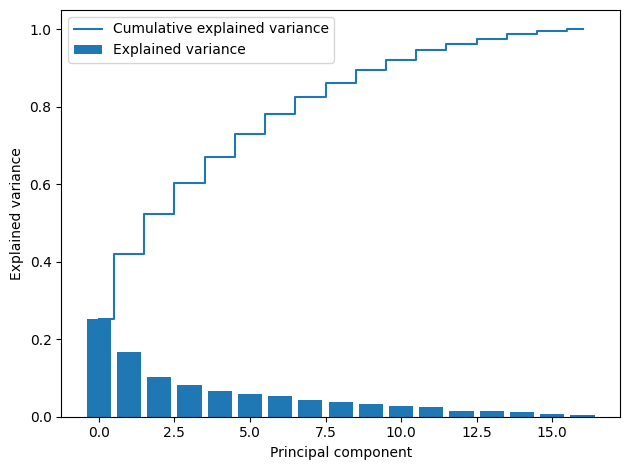

In [14]:
plt.bar(range(0,len(exp_var_pca)), exp_var_pca, align='center', label='Explained variance')
plt.step(range(0,len(cum_sum_eigenvalues)), cum_sum_eigenvalues, where='mid',label='Cumulative explained variance')
plt.ylabel('Explained variance')
plt.xlabel('Principal component')
plt.legend(loc='best')
plt.tight_layout()
plt.show()

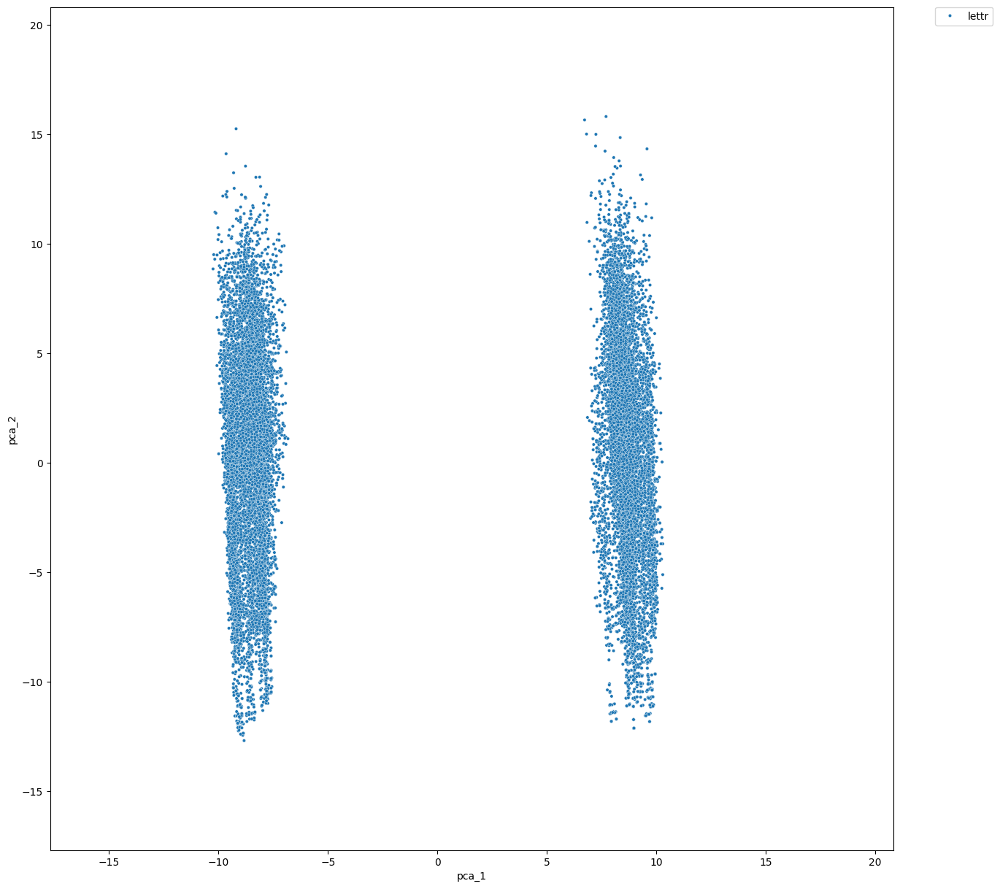

In [15]:
pca = PCA(n_components=2)
pca_result = pca.fit_transform(df)

pca_result_df = pd.DataFrame({'pca_1': pca_result[:,0], 'pca_2': pca_result[:,1], 'label': target})

fig, ax = plt.subplots(1, figsize=(15, 15))
sns.scatterplot(x='pca_1', y='pca_2', hue='label', data=pca_result_df, ax=ax,s=10)
lim = (pca_result.min()-5, pca_result.max()+5)
ax.set_xlim(lim)
ax.set_ylim(lim)
ax.set_aspect('equal')
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.0)

## TSNE

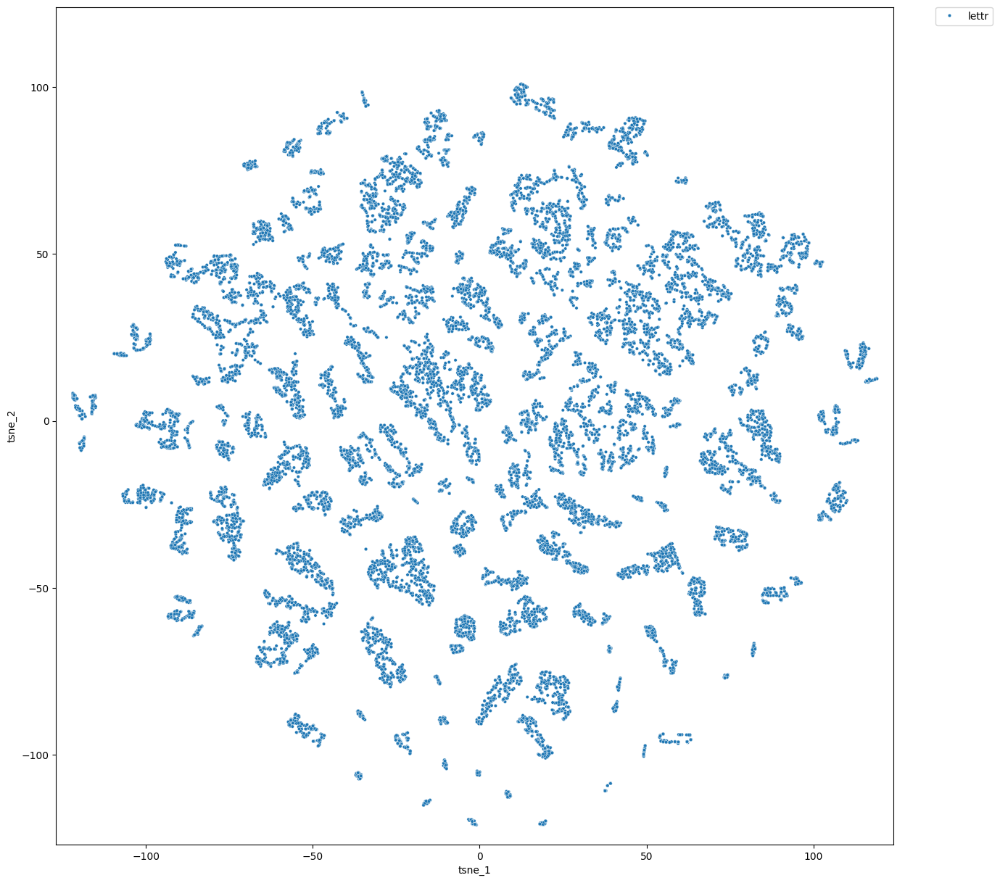

In [16]:
tsne = TSNE(n_components=2)
tsne_result = tsne.fit_transform(df)

tsne_result_df = pd.DataFrame({'tsne_1': tsne_result[:,0], 'tsne_2': tsne_result[:,1], 'label': target})

fig, ax = plt.subplots(1, figsize=(15, 15))
sns.scatterplot(x='tsne_1', y='tsne_2', hue='label', data=tsne_result_df, ax=ax,s=10)
lim = (tsne_result.min()-5, tsne_result.max()+5)
ax.set_xlim(lim)
ax.set_ylim(lim)
ax.set_aspect('equal')
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.0)


2. Кластерний аналіз
1) За допомогою алгоритму k-means зробіть квантування зображення (видалення візуально надлишкової інформації) з глибиною 64, 32, 16 та 8 рівнів для будь-якого обраного самостійно зображення.
Приклад: https://scikit-learn.org/stable/auto_examples/cluster/plot_color_quantization.html


In [17]:
from time import time

import matplotlib.pyplot as plt
import numpy as np

from sklearn.cluster import KMeans
from sklearn.datasets import load_sample_image
from sklearn.metrics import pairwise_distances_argmin
from sklearn.utils import shuffle

from PIL import Image

In [18]:
def example(file_name: str, n_colors: int=64) -> None:
    not_a_china = Image.open(file_name)

    # Convert to floats instead of the default 8 bits integer coding. Dividing by
    # 255 is important so that plt.imshow works well on float data (need to
    # be in the range [0-1])
    not_a_china = np.array(not_a_china, dtype=np.float64) / 255

    # Load Image and transform to a 2D numpy array.
    w, h, d = original_shape = tuple(not_a_china.shape)
    assert d == 3
    image_array = np.reshape(not_a_china, (w * h, d))

    print("Fitting model on a small sub-sample of the data")
    t0 = time()
    image_array_sample = shuffle(image_array, random_state=0, n_samples=1_000)
    kmeans = KMeans(n_clusters=n_colors, random_state=0).fit(image_array_sample)
    print(f"done in {time() - t0:0.3f}s.")

    # Get labels for all points
    print("Predicting color indices on the full image (k-means)")
    t0 = time()
    labels = kmeans.predict(image_array)
    print(f"done in {time() - t0:0.3f}s.")


    codebook_random = shuffle(image_array, random_state=0, n_samples=n_colors)
    print("Predicting color indices on the full image (random)")
    t0 = time()
    labels_random = pairwise_distances_argmin(codebook_random, image_array, axis=0)
    print(f"done in {time() - t0:0.3f}s.")


    def recreate_image(codebook, labels, w, h):
        """Recreate the (compressed) image from the code book & labels"""
        return codebook[labels].reshape(w, h, -1)


    # Display all results, alongside original image
    plt.figure(1, figsize=(15, 15))
    plt.clf()
    plt.axis("off")
    plt.title("Original image")
    plt.imshow(not_a_china)

    plt.figure(2, figsize=(15, 15))
    plt.clf()
    plt.axis("off")
    plt.title(f"Quantized image ({n_colors} colors, K-Means)")
    plt.imshow(recreate_image(kmeans.cluster_centers_, labels, w, h))

    plt.figure(3, figsize=(15, 15))
    plt.clf()
    plt.axis("off")
    plt.title(f"Quantized image ({n_colors} colors, Random)")
    plt.imshow(recreate_image(codebook_random, labels_random, w, h))
    plt.show()

Fitting model on a small sub-sample of the data
done in 1.183s.
Predicting color indices on the full image (k-means)
done in 0.587s.
Predicting color indices on the full image (random)
done in 1.480s.


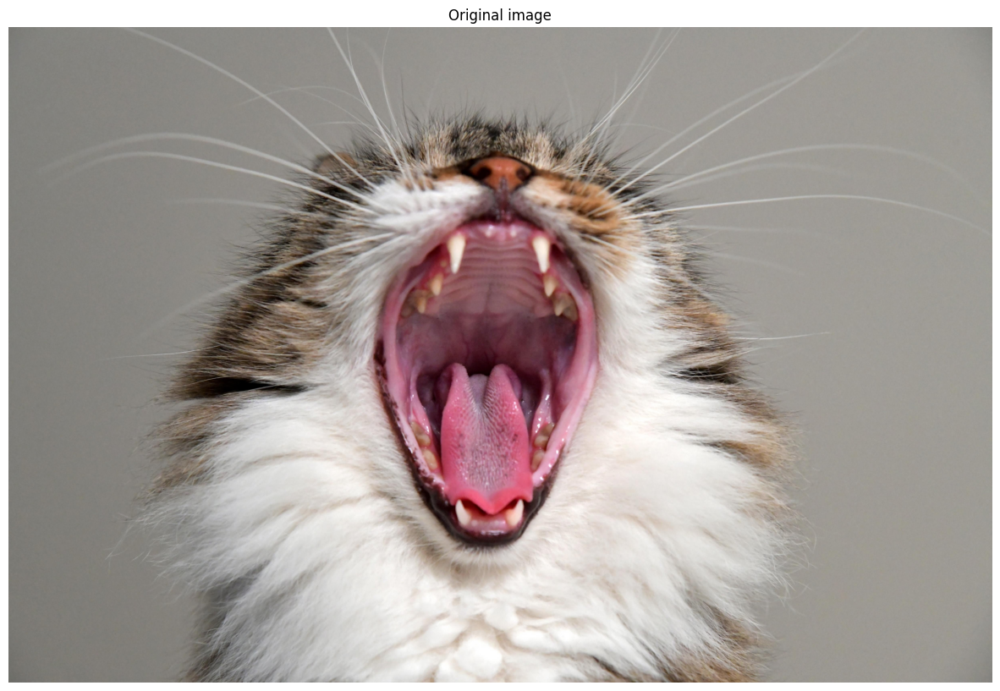

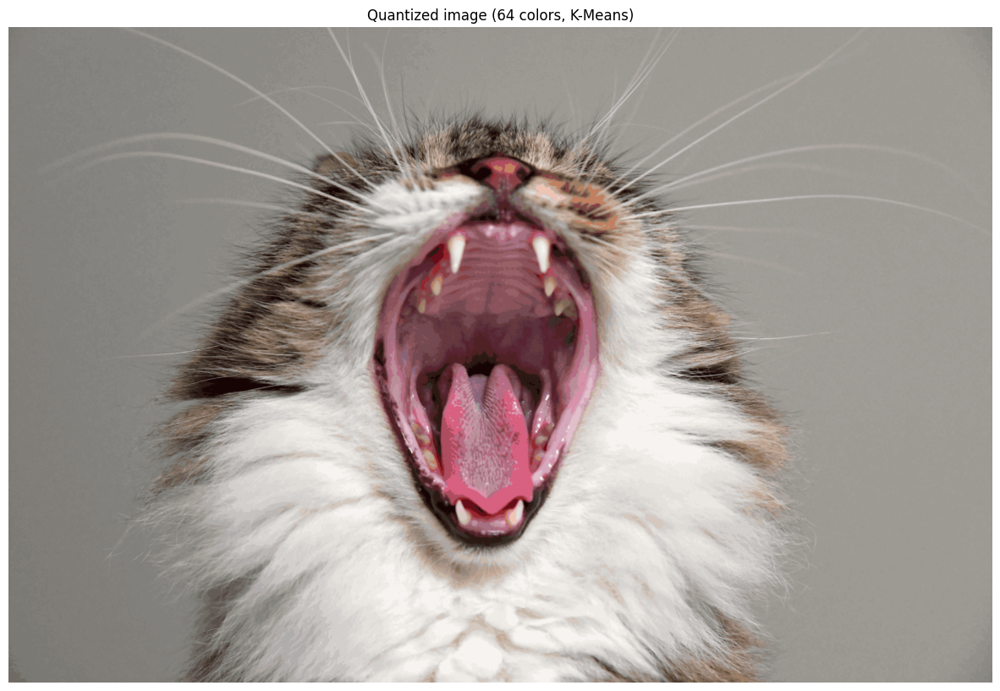

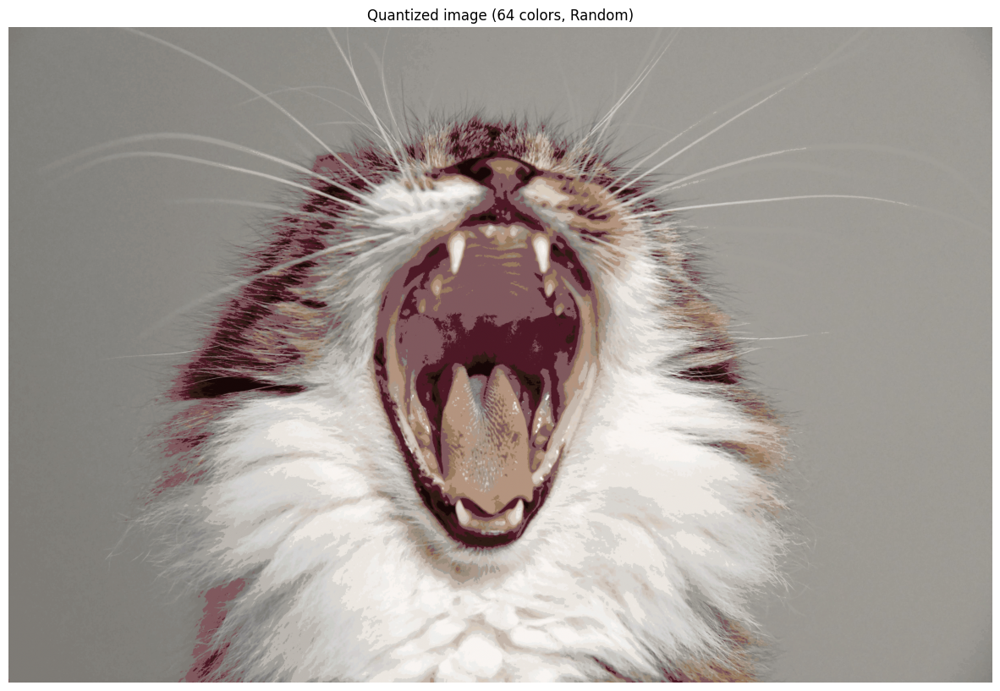

In [19]:
example("pexels-serena-koi-1576193.jpg", n_colors=64)

Fitting model on a small sub-sample of the data
done in 1.268s.
Predicting color indices on the full image (k-means)
done in 0.402s.
Predicting color indices on the full image (random)
done in 0.737s.


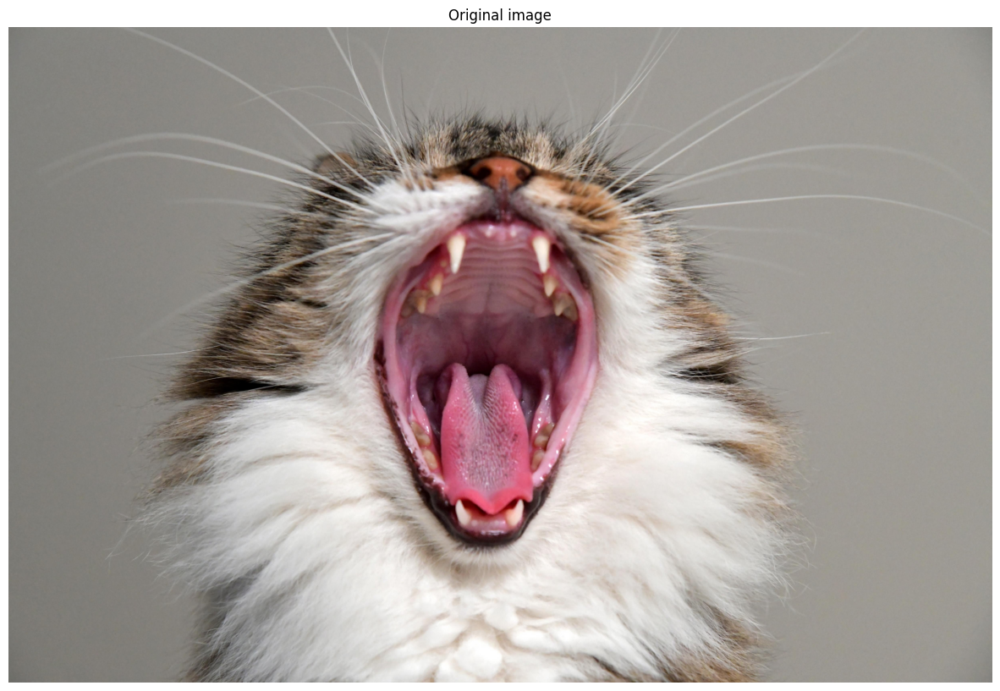

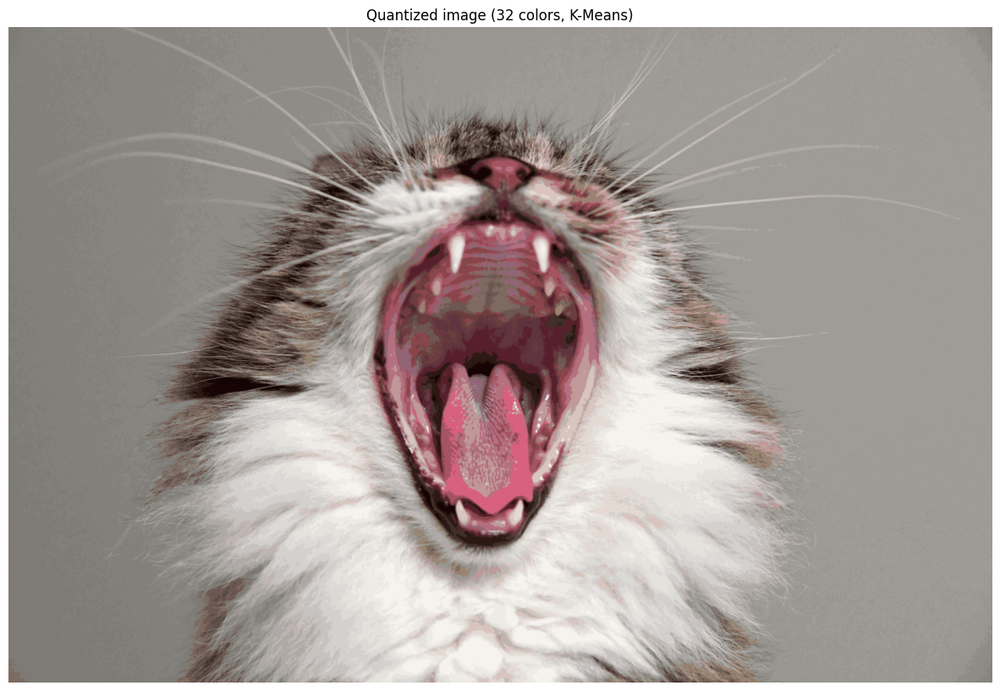

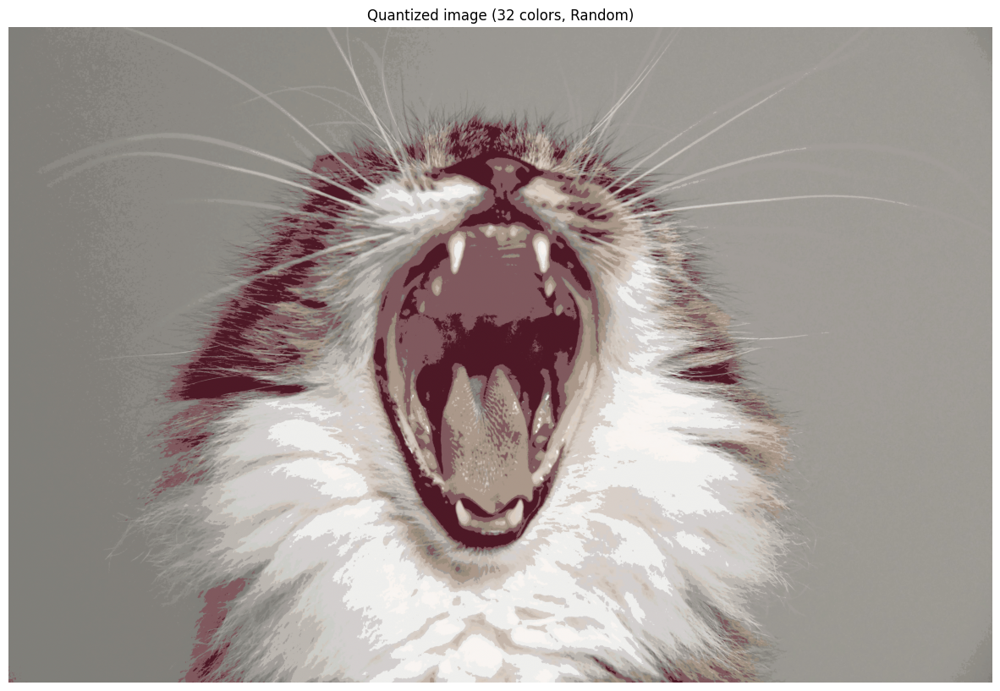

In [20]:
example("pexels-serena-koi-1576193.jpg", n_colors=32)

Fitting model on a small sub-sample of the data
done in 0.986s.
Predicting color indices on the full image (k-means)
done in 0.234s.
Predicting color indices on the full image (random)
done in 0.429s.


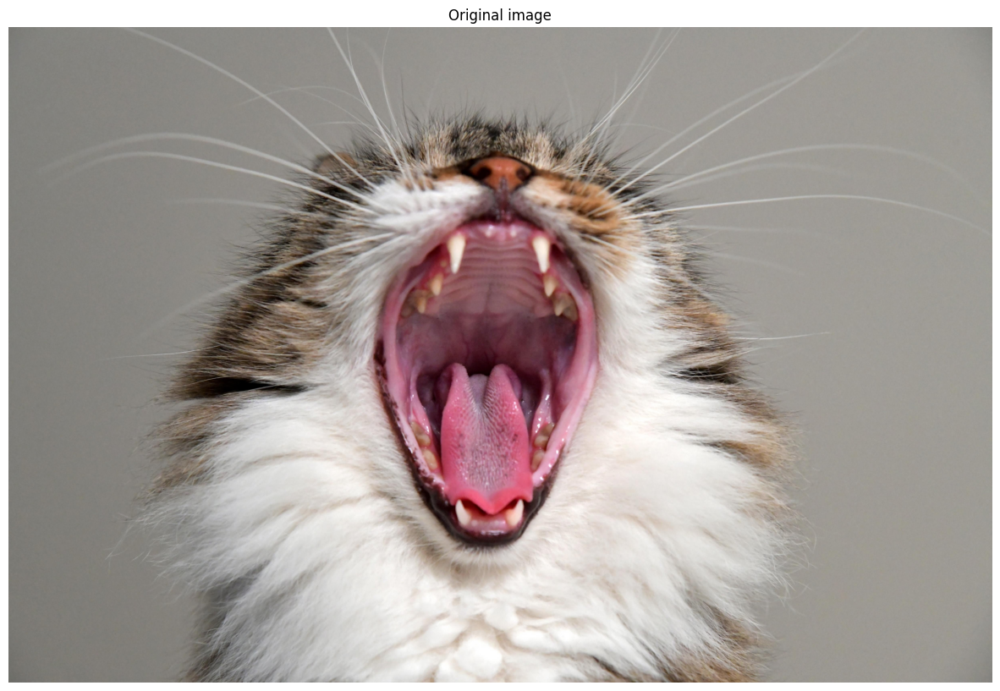

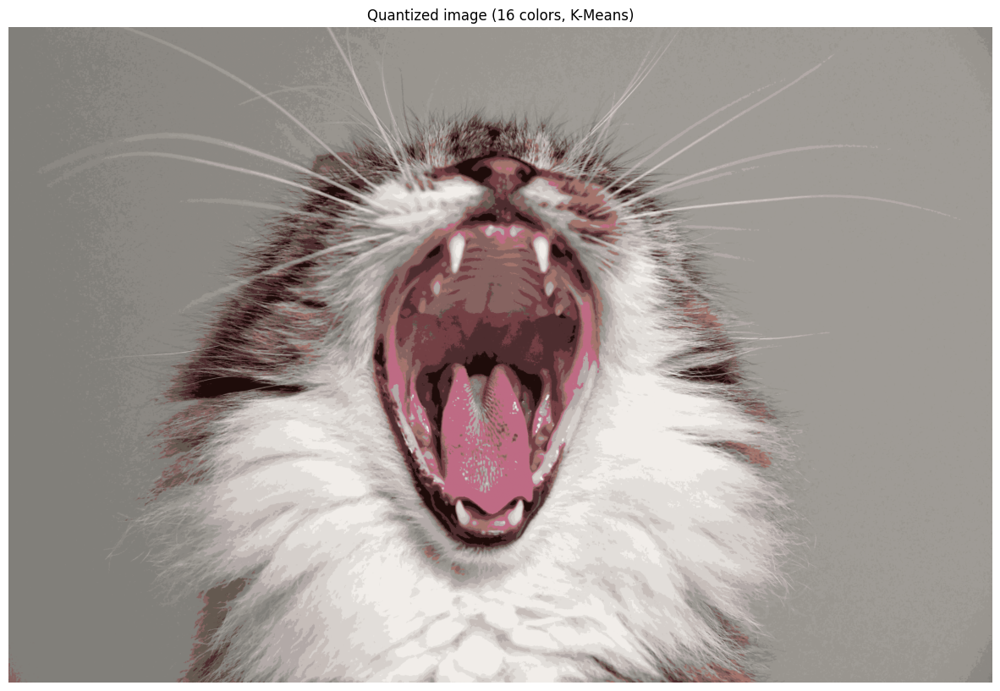

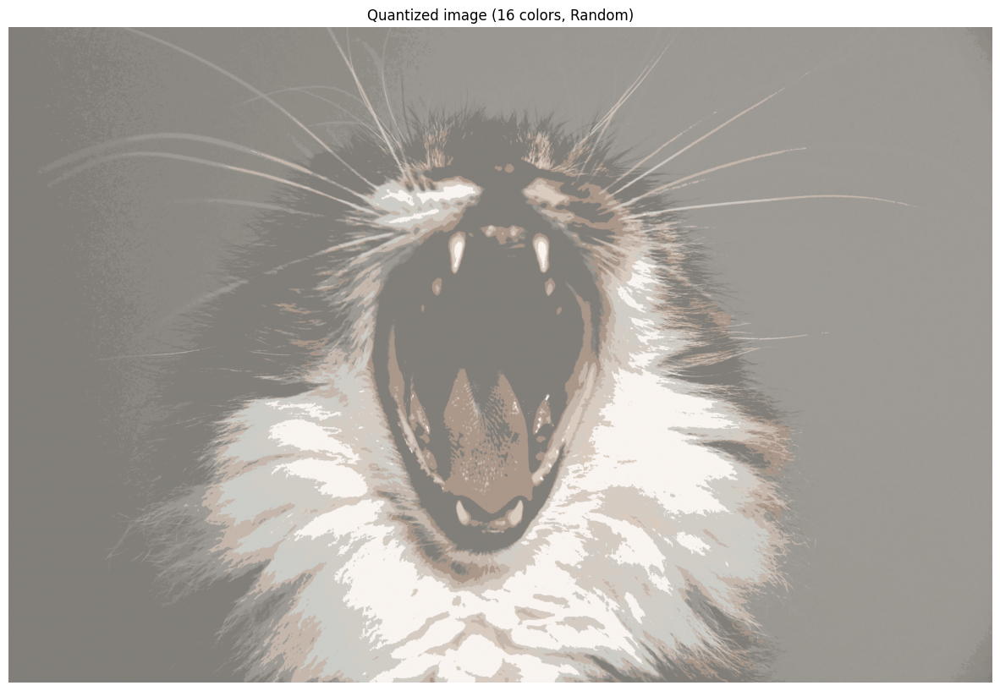

In [21]:
example("pexels-serena-koi-1576193.jpg", n_colors=16)

Fitting model on a small sub-sample of the data
done in 1.143s.
Predicting color indices on the full image (k-means)
done in 0.154s.
Predicting color indices on the full image (random)
done in 0.336s.


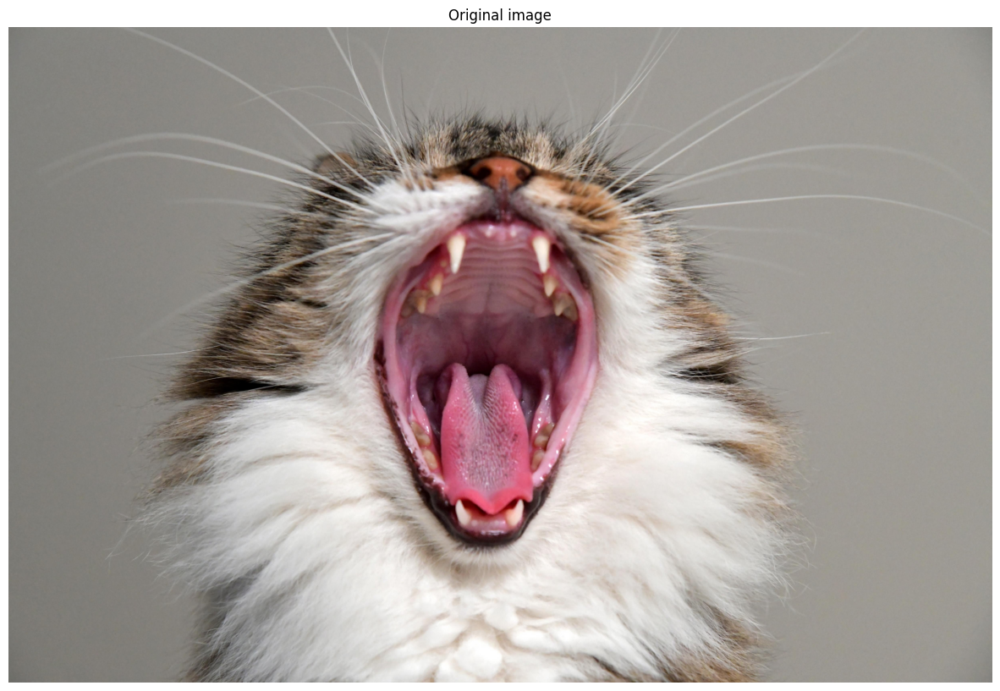

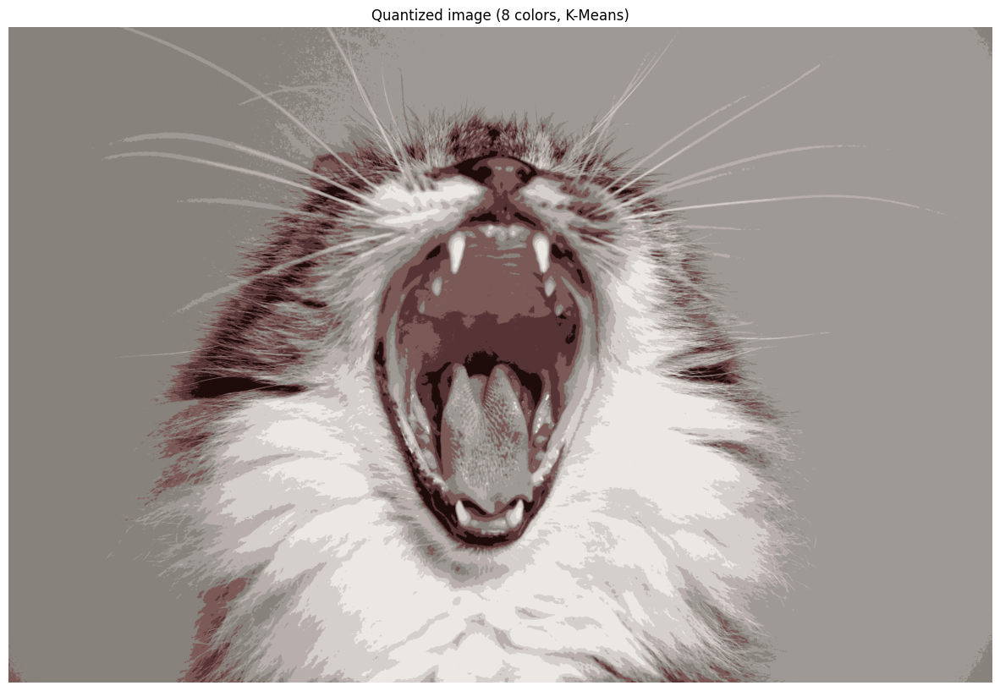

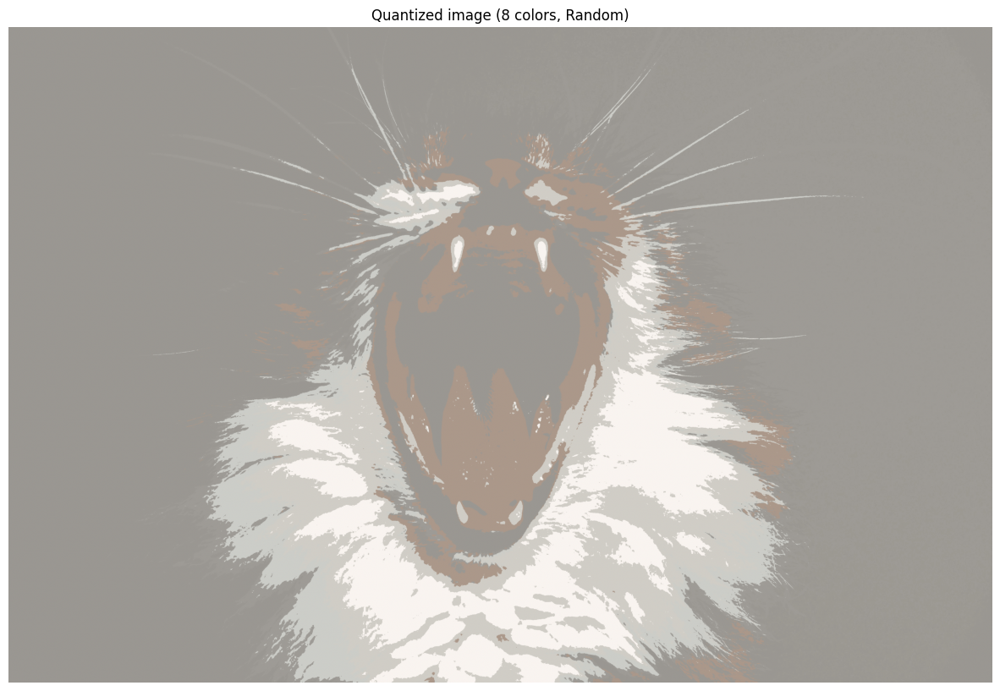

In [22]:
example("pexels-serena-koi-1576193.jpg", n_colors=8)

Fitting model on a small sub-sample of the data
done in 0.206s.
Predicting color indices on the full image (k-means)
done in 0.127s.
Predicting color indices on the full image (random)
done in 0.260s.


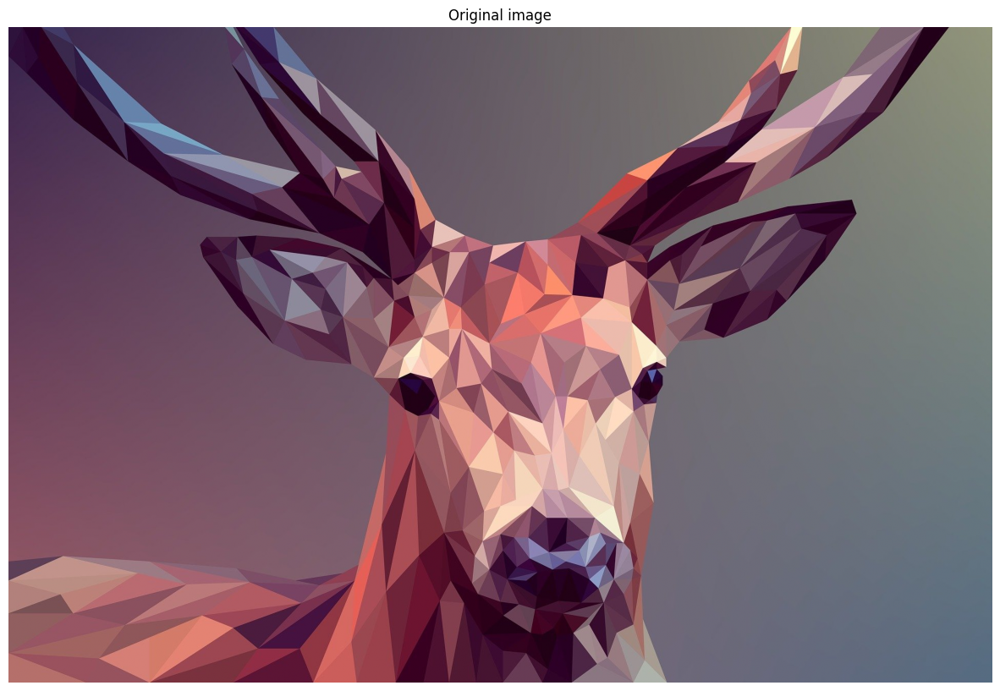

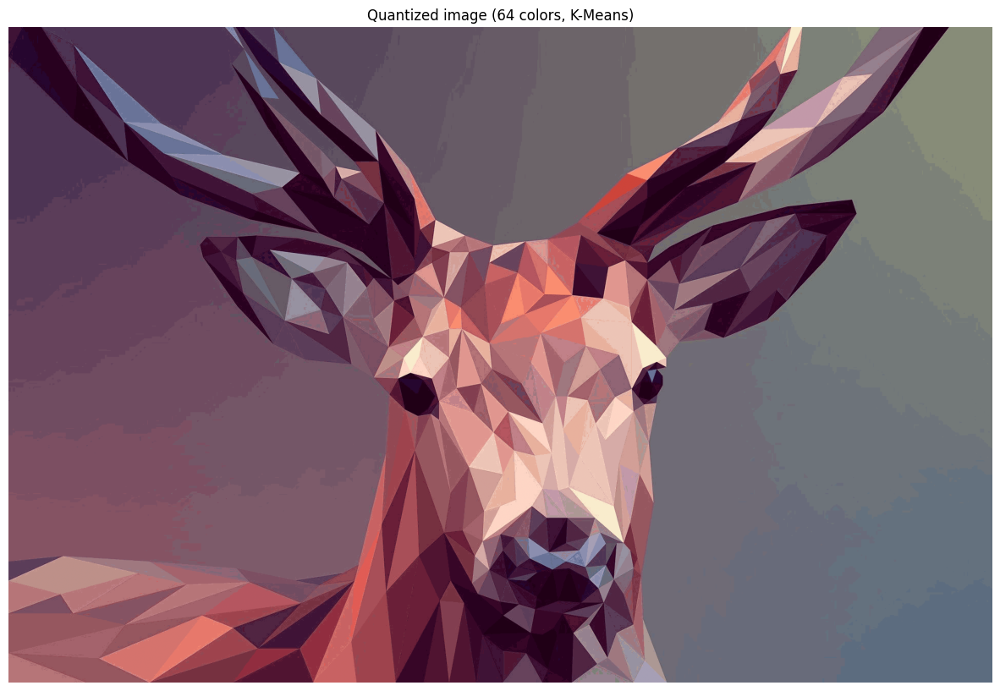

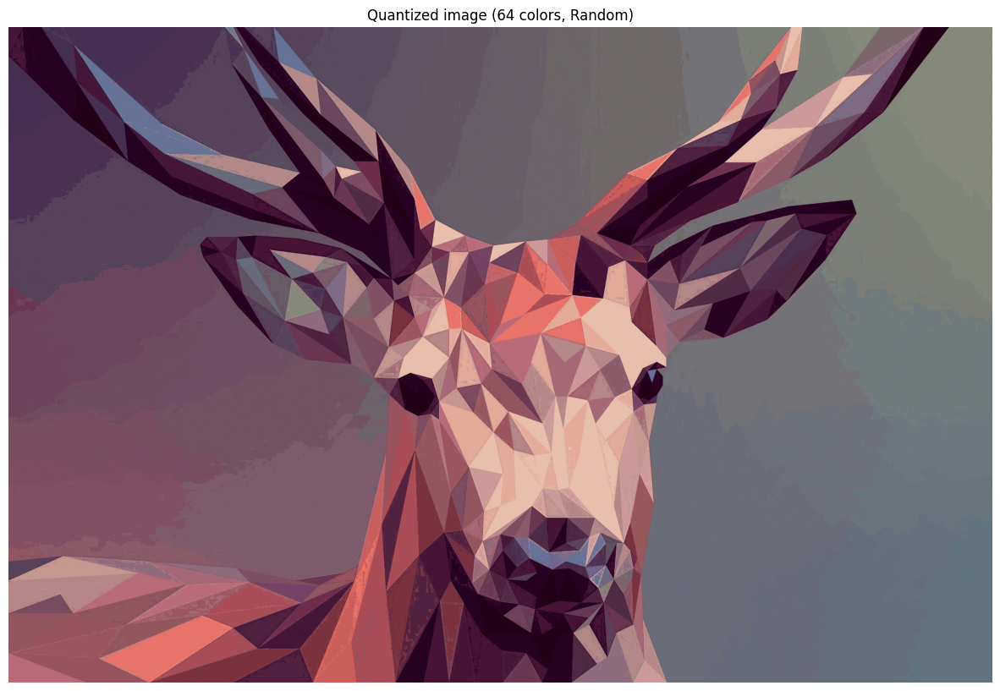

In [23]:
example("deer-g5c2f05296_1920.jpg", n_colors=64)

Fitting model on a small sub-sample of the data
done in 0.315s.
Predicting color indices on the full image (k-means)
done in 0.076s.
Predicting color indices on the full image (random)
done in 0.160s.


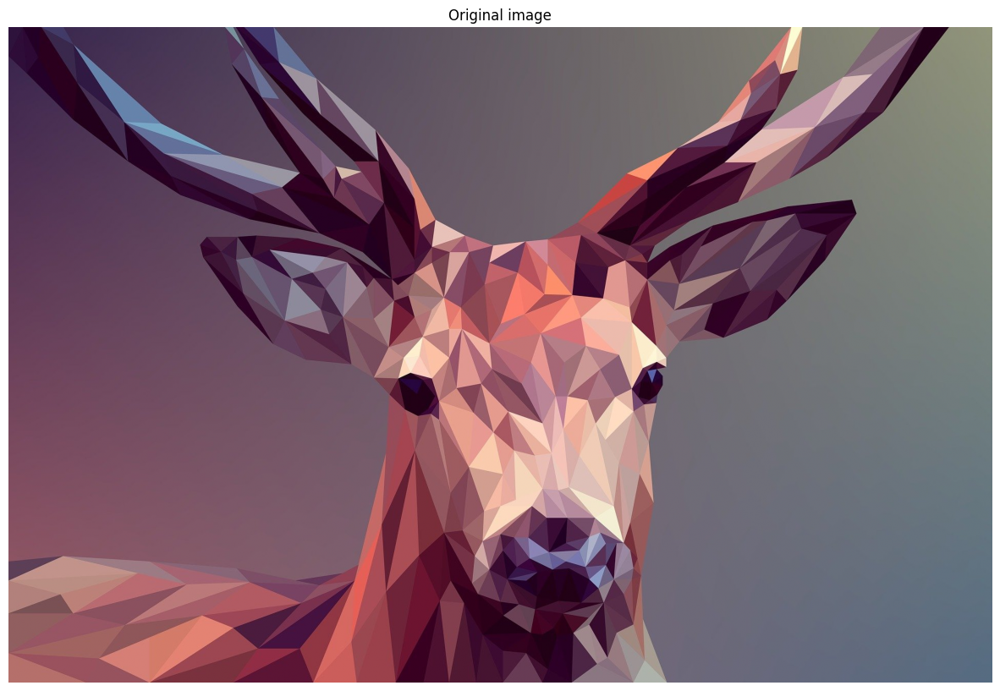

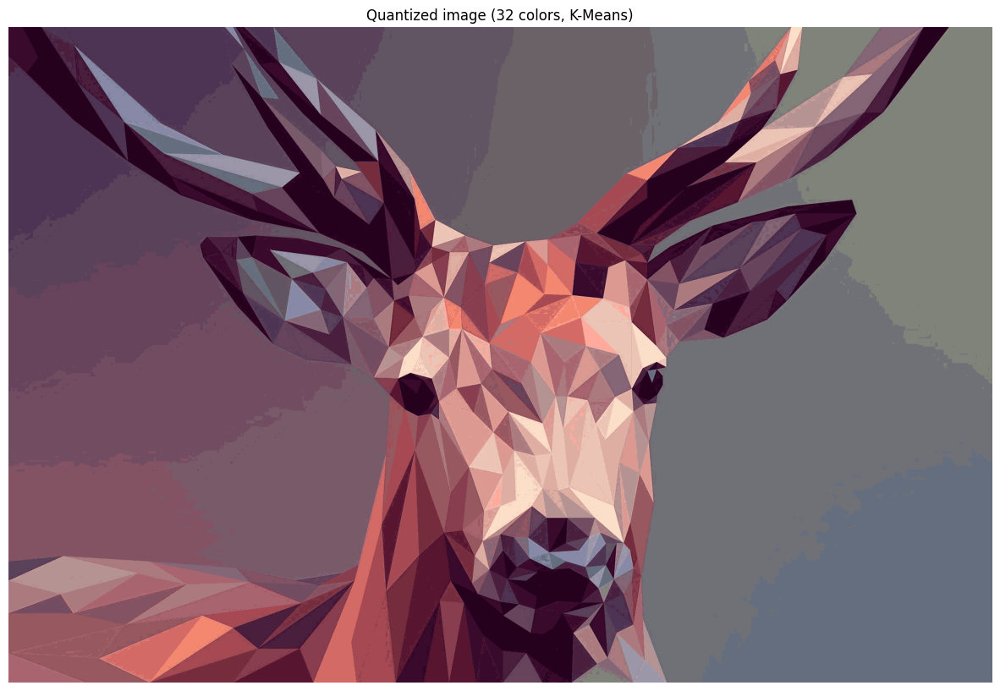

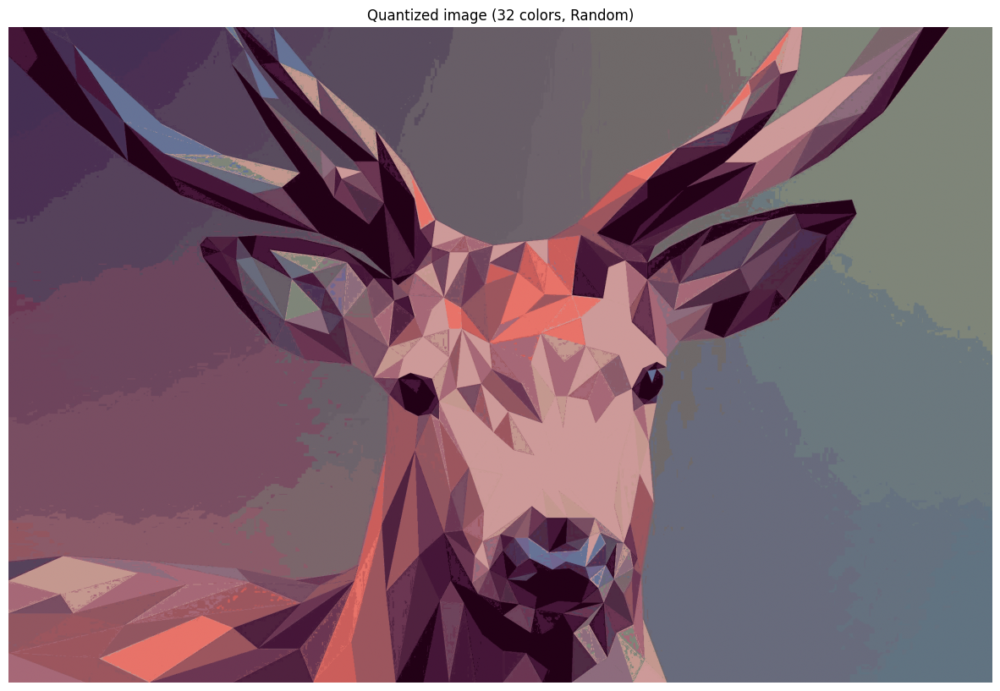

In [24]:
example("deer-g5c2f05296_1920.jpg", n_colors=32)

Fitting model on a small sub-sample of the data
done in 0.185s.
Predicting color indices on the full image (k-means)
done in 0.038s.
Predicting color indices on the full image (random)
done in 0.094s.


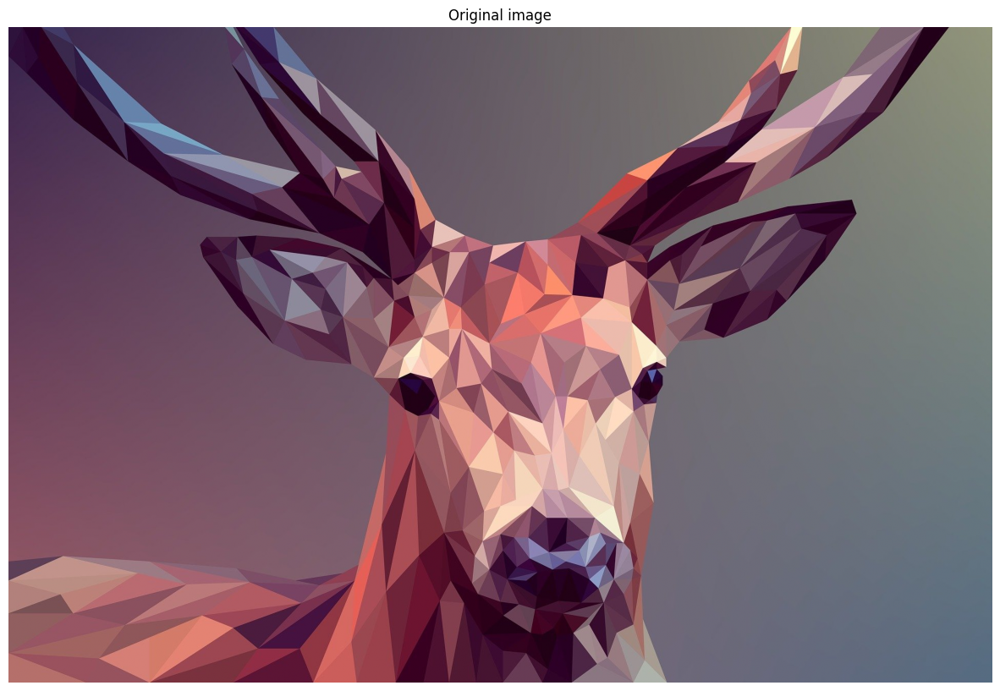

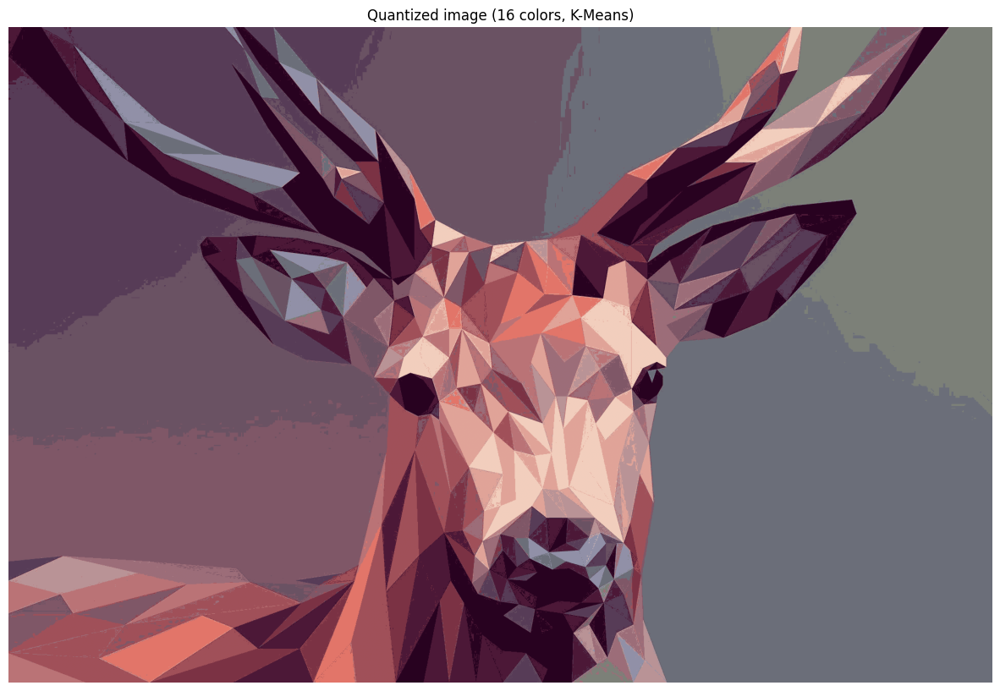

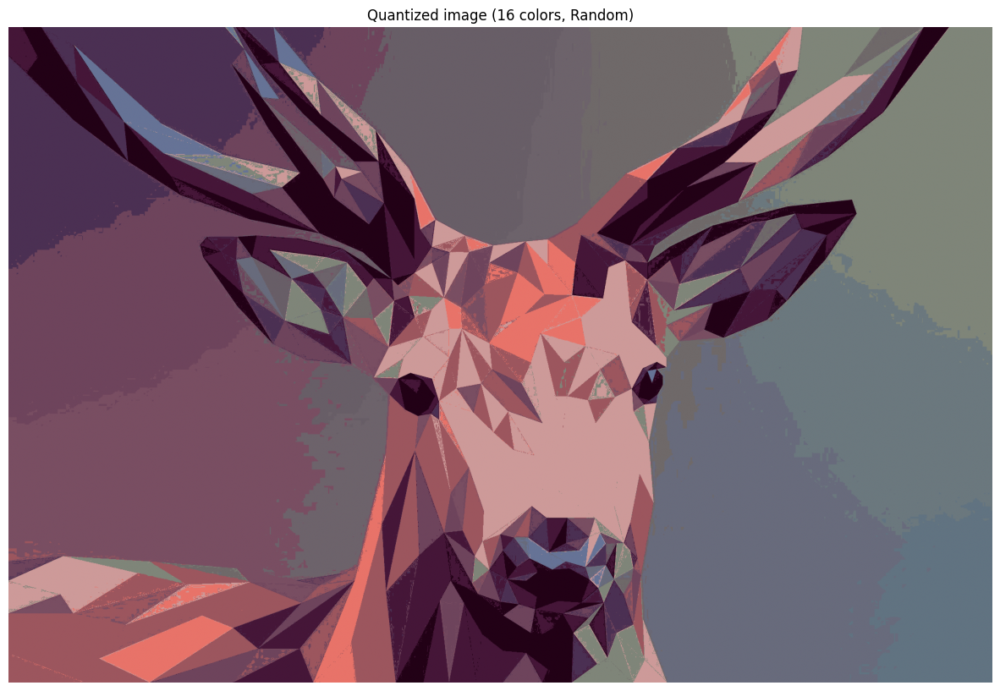

In [25]:
example("deer-g5c2f05296_1920.jpg", n_colors=16)

Fitting model on a small sub-sample of the data
done in 0.142s.
Predicting color indices on the full image (k-means)
done in 0.022s.
Predicting color indices on the full image (random)
done in 0.059s.


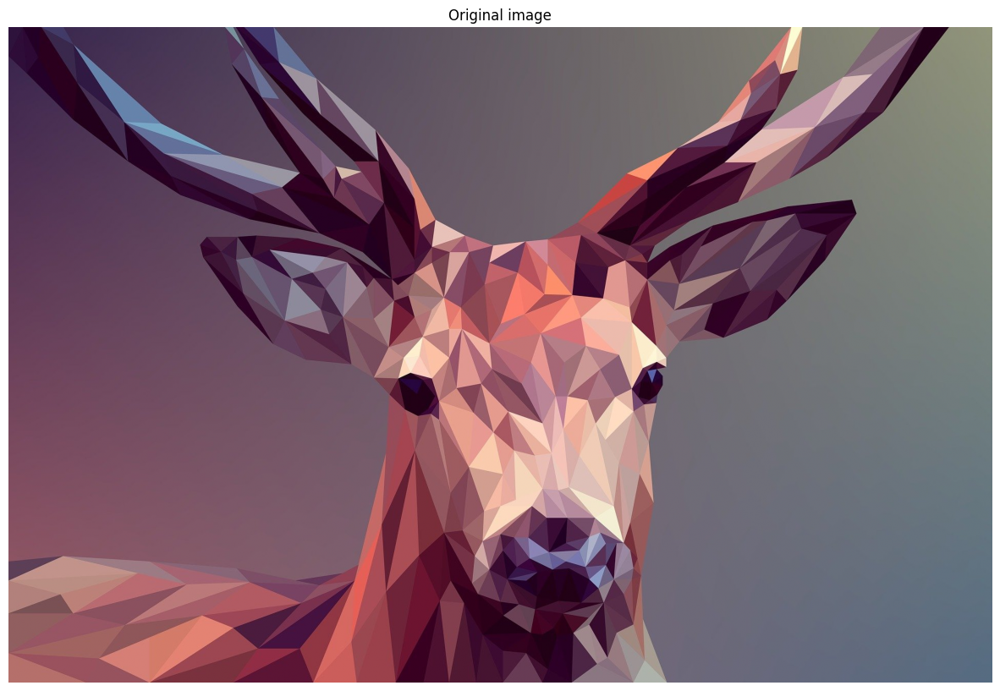

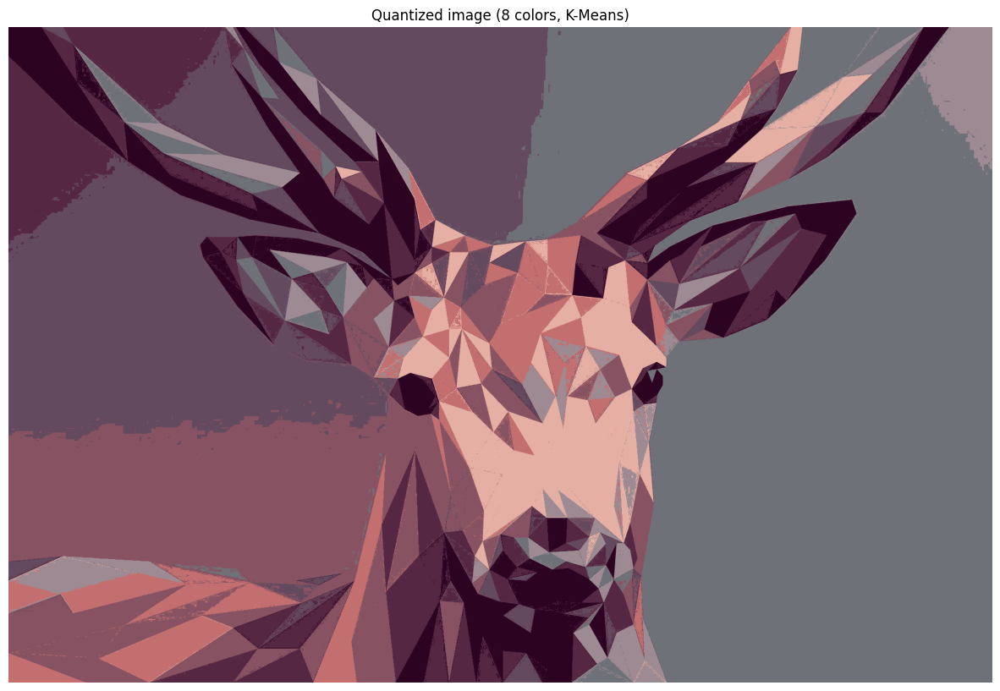

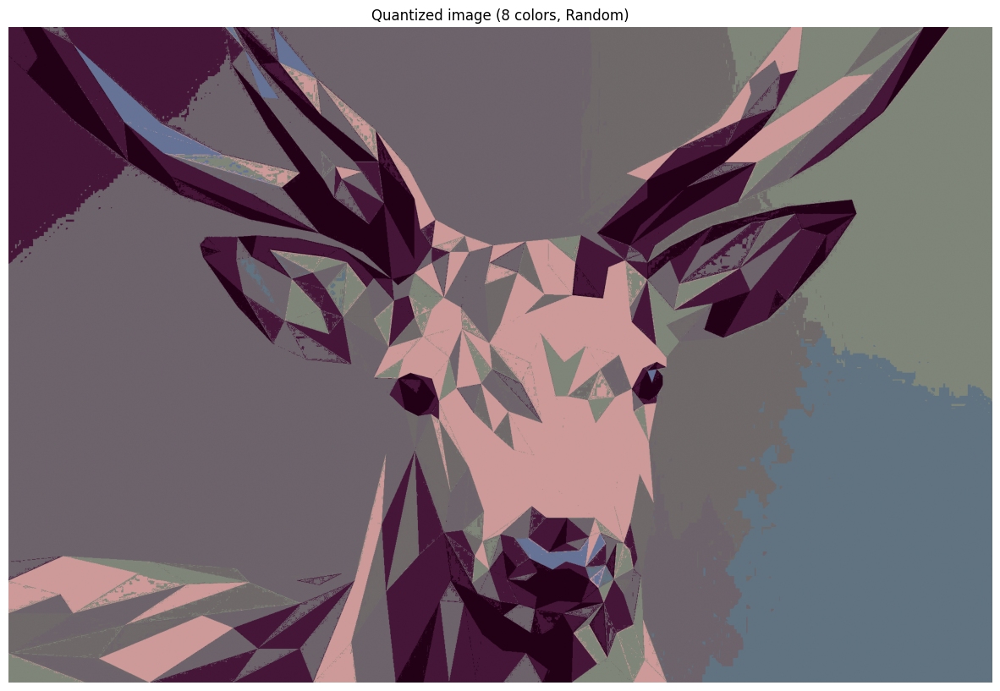

In [26]:
example("deer-g5c2f05296_1920.jpg", n_colors=8)

3. Обробка та класифікація текстових даних
Завантажте набір текстових даних (з мітками класів). Проведіть передобробку даних (видаліть стоп-слова, пунктуацію), за допомогою wordcloud зробіть візуалізацію найбільш поширених слів або n-gram у кожному класі. Векторизуйте тексти (наприклад за допомогою sklearn.feature_extraction.text.TfidfVectorizer). Проведіть класифікацію текстових даних, зробіть оцінку якості. 
Приклад: https://github.com/natsakh/Data-Analysis/tree/main/Pr_4
Текстові дані для аналізу можна обирати тут:
https://analyticsindiamag.com/10-open-source-datasets-for-text-classification
https://www.ics.uci.edu/~smyth/courses/cs175/text_data_sets.html
https://medium.com/@ODSC/20-open-datasets-for-natural-language-processing-538fbfaf8e38
https://odsc.medium.com/20-open-datasets-for-natural-language-processing-538fbfaf8e38
https://imerit.net/blog/25-best-nlp-datasets-for-machine-learning-all-pbm/
https://www.kaggle.com/
або з будь-якого іншого джерела за вашим вибором
(в разі великої кількості класів достатньо залишити 2-3)

Датасет IMDB Movie Review Sentiment classification не обирайте



In [27]:
import nltk
nltk.download('punkt_tab')
nltk.download('stopwords')
nltk.download('wordnet')

from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer, WordNetLemmatizer

from wordcloud import WordCloud
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report,confusion_matrix
from sklearn.model_selection import train_test_split

[nltk_data] Downloading package punkt_tab to /home/anna/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt_tab.zip.
[nltk_data] Downloading package stopwords to /home/anna/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /home/anna/nltk_data...


In [28]:
data_test = []
with open("archive/test.ft.txt", "rt") as file:
    for line in file:
        data_test.append(line.split(" ", 1))

df_test = pd.DataFrame(np.array(data_test), columns=['target', 'text'])

df_test.head()

,target,text
0,__label__2,Great CD: My lovely Pat has one of the GREAT v...
1,__label__2,One of the best game music soundtracks - for a...
2,__label__1,Batteries died within a year ...: I bought thi...
3,__label__2,"works fine, but Maha Energy is better: Check o..."
4,__label__2,Great for the non-audiophile: Reviewed quite a...


In [29]:
def df_to_list(df) -> list[str]:
    data = []
    for i in df.keys():
        data.append(df[i])

    return data

In [31]:
train, test = train_test_split(df_test, test_size=0.5)

train_target = train["target"]
train_data = train["text"]

test_target = test["target"]
test_data = test["text"]


train_target = df_to_list(df=train_target)
train_data = df_to_list(df=train_data)

test_target = df_to_list(df=test_target)
test_data = df_to_list(df=test_data)

## Visualisation

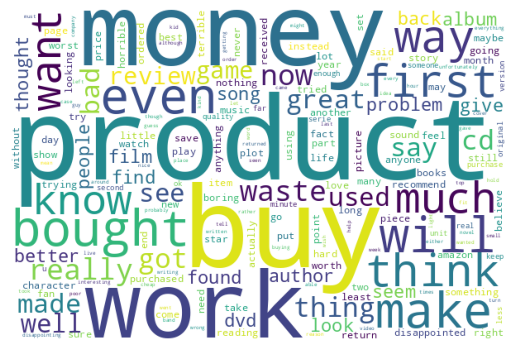

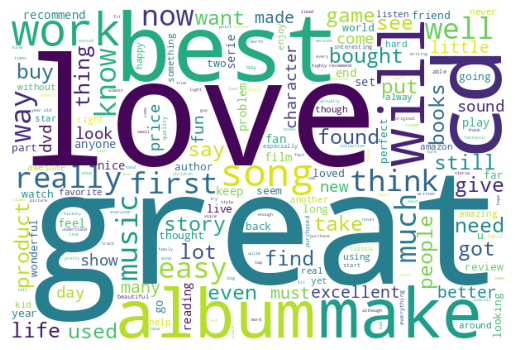

In [32]:
def visualize(label, df):
    text = ''
    for msg in df_test[df['target'] == label]['text']:
        msg = msg.lower()
        text += msg + ' '
    # 
    w = WordCloud()
    stop_words = list(w.stopwords)
    custom_stop_words = ['movie', 'book', 'one', 'read', 'good', 'time', 'use']
    stop_words = set(stop_words + custom_stop_words)

    wordcloud = WordCloud(width=600, height=400, background_color="white", stopwords=stop_words).generate(text)

    # plt.figure(figsize=(20,10), facecolor='k')
    plt.imshow(wordcloud)
    plt.axis('off')
    plt.show()

visualize('__label__1', df=df_test)
visualize('__label__2', df=df_test)

## Vectorization with TFIDF

In [33]:
tfidf_vectorizer = TfidfVectorizer(max_df=500, min_df=5)

tfidf_train = tfidf_vectorizer.fit_transform(train_data)
tfidf_test =  tfidf_vectorizer.transform(test_data)

clf = LogisticRegression().fit(tfidf_train, train_target)

predicted = clf.predict(tfidf_test)
print(classification_report(test_target, predicted))

              precision    recall  f1-score   support

  __label__1       0.76      0.71      0.73    100278
  __label__2       0.72      0.77      0.75     99722

    accuracy                           0.74    200000
   macro avg       0.74      0.74      0.74    200000
weighted avg       0.74      0.74      0.74    200000

